# NYC Taxi Trip Duration  Dataset Analysis 🚖🌦️

## Taxi Trip Data Fields

- **id**: A unique identifier for each trip 🆔
- **vendor_id**: A code indicating the provider associated with the trip record 🏢
- **pickup_datetime**: Date and time when the meter was engaged ⏱️
- **dropoff_datetime**: Date and time when the meter was disengaged 🕒
- **passenger_count**: The number of passengers in the vehicle (driver entered value) 🚗
- **pickup_longitude**: The longitude where the meter was engaged 📍
- **pickup_latitude**: The latitude where the meter was engaged 🌍
- **dropoff_longitude**: The longitude where the meter was disengaged 📍
- **dropoff_latitude**: The latitude where the meter was disengaged 🌍
- **store_and_fwd_flag**: Indicates if the trip record was held in vehicle memory before sending to the vendor due to lack of server connection. Y = store and forward; N = not a store and forward trip 🗂️
- **trip_duration**: Duration of the trip in seconds ⏳




In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go 
import plotly.io as pio 
import plotly.colors as colors
from sklearn.cluster import KMeans
from sklearn.neighbors import KNeighborsClassifier
import io
import base64
#to ignore warnings
import warnings
warnings.filterwarnings('ignore')
# plt.style.use('https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-light.mplstyle')
plt.style.use('https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-dark.mplstyle')

# Set the maximum number of columns to display
pd.options.display.max_columns = None
# Set the maximum number of rows to display
pd.options.display.max_rows = 20

plt.rc("figure", figsize=(22, 8))


## Read data and discover it

This section involves reading the data and exploring its characteristics to gain insights.


In [2]:
taxi_data =pd.read_csv('./Data/train.csv')
weather_data =pd.read_csv('./Data/weather_data_nyc_centralpark_2016.csv')


In [3]:
taxi_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 10 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   id                  1000000 non-null  object 
 1   vendor_id           1000000 non-null  int64  
 2   pickup_datetime     1000000 non-null  object 
 3   passenger_count     1000000 non-null  int64  
 4   pickup_longitude    1000000 non-null  float64
 5   pickup_latitude     1000000 non-null  float64
 6   dropoff_longitude   1000000 non-null  float64
 7   dropoff_latitude    1000000 non-null  float64
 8   store_and_fwd_flag  1000000 non-null  object 
 9   trip_duration       1000000 non-null  int64  
dtypes: float64(4), int64(3), object(3)
memory usage: 76.3+ MB


## Preprocessing


In [4]:
taxi_data['pickup_datetime'] = pd.to_datetime(taxi_data['pickup_datetime'])
taxi_data['pickup_hour'] = taxi_data['pickup_datetime'].dt.hour
taxi_data['trip_duration_minutes'] = taxi_data['trip_duration'] / 60

In [5]:
# Extract day of the week (0 = Monday, 6 = Sunday)
taxi_data['day_of_week'] = taxi_data['pickup_datetime'].dt.dayofweek

In [6]:
# Extract year, month, and season
taxi_data['year'] = taxi_data['pickup_datetime'].dt.year
taxi_data['month'] = taxi_data['pickup_datetime'].dt.month
taxi_data['season'] = taxi_data['pickup_datetime'].dt.month % 12 // 3 + 1


In [7]:
taxi_data.isna().sum()

id                       0
vendor_id                0
pickup_datetime          0
passenger_count          0
pickup_longitude         0
pickup_latitude          0
dropoff_longitude        0
dropoff_latitude         0
store_and_fwd_flag       0
trip_duration            0
pickup_hour              0
trip_duration_minutes    0
day_of_week              0
year                     0
month                    0
season                   0
dtype: int64

In [8]:
taxi_data.describe()

,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration,pickup_hour,trip_duration_minutes,day_of_week,year,month,season
count,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1.000000e+06,1000000.000000,1000000.000000,1000000.000000,1000000.0,1000000.000000,1000000.000000
mean,1.534793,1.665353,-73.973475,40.750947,-73.973421,40.751829,9.548850e+02,13.604165,15.914750,3.051486,2016.0,3.515209,1.839042
std,0.498788,1.315723,0.065404,0.033745,0.065432,0.035782,3.882070e+03,6.400685,64.701169,1.954644,0.0,1.681171,0.675156
min,1.000000,0.000000,-121.933342,34.359695,-121.933304,34.359695,1.000000e+00,0.000000,0.016667,0.000000,2016.0,1.000000,1.000000
25%,1.000000,1.000000,-73.991852,40.737372,-73.991341,40.735928,3.970000e+02,9.000000,6.616667,1.000000,2016.0,2.000000,1.000000
50%,2.000000,1.000000,-73.981728,40.754131,-73.979767,40.754551,6.620000e+02,14.000000,11.033333,3.000000,2016.0,4.000000,2.000000
75%,2.000000,2.000000,-73.967346,40.768379,-73.963036,40.769833,1.074000e+03,19.000000,17.900000,5.000000,2016.0,5.000000,2.000000
max,2.000000,7.000000,-61.335529,51.881084,-61.335529,43.921028,2.227612e+06,23.000000,37126.866667,6.000000,2016.0,6.000000,3.000000


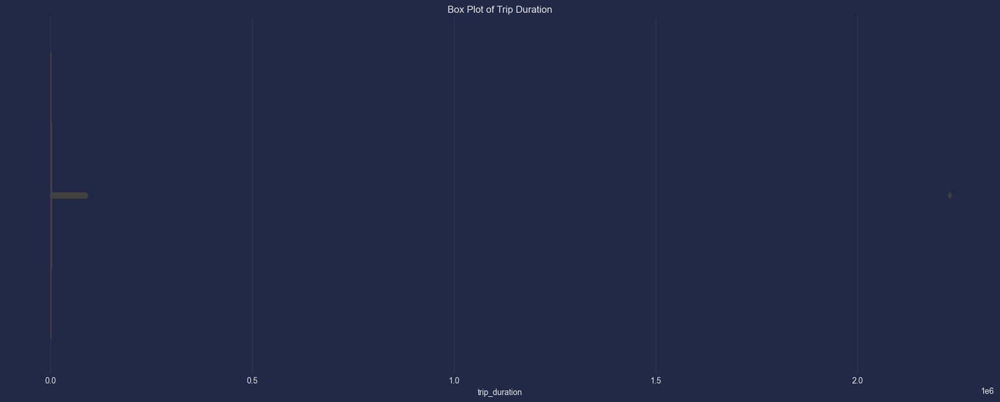

In [9]:
sns.boxplot(x=taxi_data['trip_duration'])
plt.title('Box Plot of Trip Duration')
plt.show()

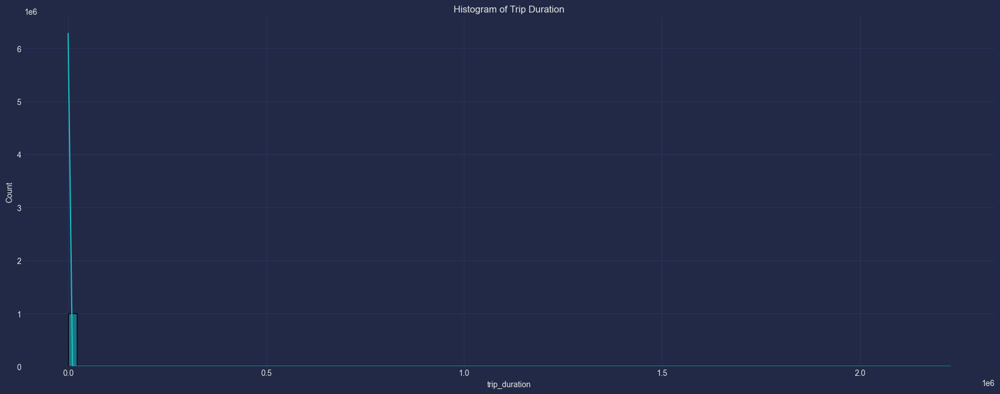

In [10]:
sns.histplot(taxi_data['trip_duration'], bins=100, kde=True)
plt.title('Histogram of Trip Duration')
plt.show()

### Filter by Geographic Limits


In [11]:
xlim = [-74.03, -73.77]
ylim = [40.63, 40.85]
taxi_data = taxi_data[
    (taxi_data.pickup_longitude > xlim[0]) & (taxi_data.pickup_longitude < xlim[1]) & 
    (taxi_data.dropoff_longitude > xlim[0]) & (taxi_data.dropoff_longitude < xlim[1]) &
    (taxi_data.pickup_latitude > ylim[0]) & (taxi_data.pickup_latitude < ylim[1]) & 
    (taxi_data.dropoff_latitude > ylim[0]) & (taxi_data.dropoff_latitude < ylim[1])
]

In [12]:
taxi_data.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,pickup_hour,trip_duration_minutes,day_of_week,year,month,season
0,id2793718,2,2016-06-08 07:36:19,1,-73.985611,40.735943,-73.980331,40.760468,N,1040,7,17.333333,2,2016,6,3
1,id3485529,2,2016-04-03 12:58:11,1,-73.978394,40.764351,-73.991623,40.749859,N,827,12,13.783333,6,2016,4,2
2,id1816614,2,2016-06-05 02:49:13,5,-73.989059,40.744389,-73.973381,40.748692,N,614,2,10.233333,6,2016,6,3
3,id1050851,2,2016-05-05 17:18:27,2,-73.990326,40.731136,-73.991264,40.748917,N,867,17,14.450000,3,2016,5,2
4,id0140657,1,2016-05-12 17:43:38,4,-73.789497,40.646675,-73.987137,40.759232,N,4967,17,82.783333,3,2016,5,2


In [13]:
taxi_data.shape

(986192, 16)

## Trip Duration Analysis 📊🕒


## Overall Analysis ⏲️

This section examines the general characteristics of trip durations, including average trip times and how they are distributed across all trips.


### What is the average trip duration?


In [14]:
# Calculate and print the average trip duration in minutes
average_trip_duration_minutes = taxi_data['trip_duration_minutes'].mean()
print(f'Average Trip Duration: {average_trip_duration_minutes:.2f} minutes')


Average Trip Duration: 15.68 minutes


The average trip duration is 15.68 minutes. This means that, on average, each taxi ride in the dataset lasts approximately 15 minutes and 41 seconds


### What is the distribution of trip durations?


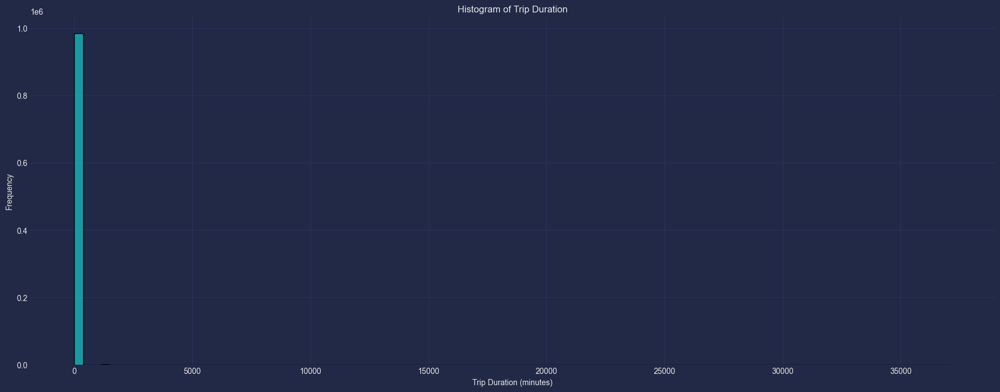

In [15]:
sns.histplot(taxi_data['trip_duration_minutes'], bins=100)
plt.title('Histogram of Trip Duration')
plt.xlabel('Trip Duration (minutes)')
plt.ylabel('Frequency')
plt.show()

## Hourly Analysis ⏳

This section explores how trip volumes and durations change throughout the day, identifying any specific times when trips are more frequent or longer.


### How does trip volume vary by hour of the day?


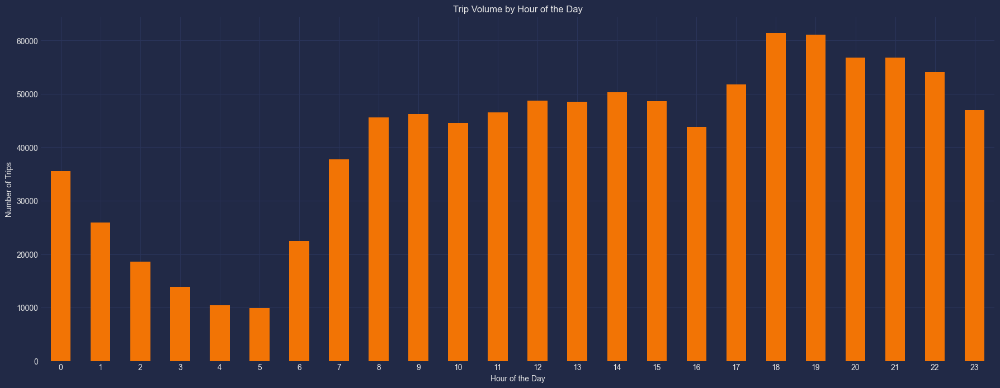

In [16]:
# Group by the pickup hour and count the number of trips
trip_volume_by_hour = taxi_data.groupby('pickup_hour').size()

# Plot the trip volume by hour of the day
trip_volume_by_hour.plot(kind='bar' , color ='#F27405')
plt.title('Trip Volume by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Trips')
plt.xticks(rotation=0)
plt.show()


**Intuition:**

- Trip volumes are lower during the early morning hours (00:00-06:00), with a significant drop from midnight to 05:00, reflecting reduced demand during late-night and early-morning hours.
- Trip volumes start to increase significantly at 06:00, peaking at 18:00 and 19:00, indicating high demand during evening hours likely due to people commuting home from work or going out for evening activities.
- There is a steady increase in trip volume from 07:00, reaching a high between 08:00 and 14:00, and peaking again in the late afternoon and early evening, suggesting consistent daytime activity and a second peak during typical commuting hours.
- After 19:00, trip volumes begin to gradually decrease, but still remain relatively high until around 22:00, likely due to continued evening activities and night shifts ending.


---


### What is the average trip duration by hour of the day?


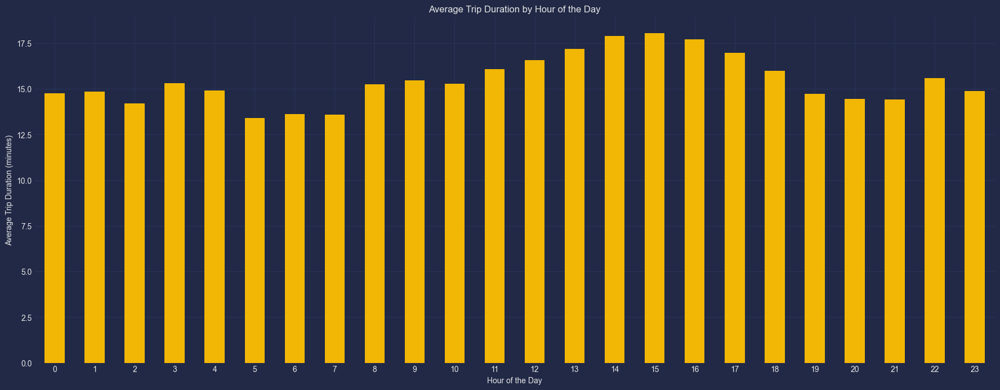

In [17]:
average_duration_by_hour = taxi_data.groupby('pickup_hour')['trip_duration_minutes'].mean()
average_duration_by_hour.plot(kind='bar', color='#F2B705')
plt.title('Average Trip Duration by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Trip Duration (minutes)')
plt.xticks(rotation=0)
plt.show()

**Intuition:**

- Trip durations are relatively lower in the early morning hours (00:00-05:00), with a noticeable dip at 05:00 (13.39 minutes), indicating that trips during these hours are generally shorter.
- Average trip durations increase starting from 08:00, peaking significantly during the mid-afternoon to early evening (12:00-16:00), with the highest average duration at 15:00 (18.05 minutes). This peak likely corresponds to increased traffic congestion and longer commute times during these hours.
- After 17:00, trip durations gradually decrease, with another smaller peak around 22:00 (15.57 minutes), potentially due to evening activities and the end of various night shifts.
- The shortest average trip durations occur at 05:00 (13.39 minutes) and early morning hours (06:00-07:00), which could be attributed to less traffic and fewer stops.

Overall, the average trip duration tends to be higher during the middle of the day and early evening, reflecting the impact of traffic patterns and commuting behavior.


---


### Are there peak hours where trip durations are longer or shorter?


In [18]:
peak_hours_volume = trip_volume_by_hour.nlargest(3)
print(f'Peak hours based on trip volume: {peak_hours_volume.index.tolist()}')

peak_hours_duration = average_duration_by_hour.nlargest(3)
print(f'Peak hours based on average trip duration: {peak_hours_duration.index.tolist()}')


Peak hours based on trip volume: [18, 19, 21]
Peak hours based on average trip duration: [15, 14, 16]


**Intuition:**

- **Peak hours based on trip volume**: The hours with the highest trip volumes, indicating peak demand for taxi rides, are 18:00, 19:00, and 21:00. During these hours, there is likely increased activity, such as people commuting home from work or heading out for evening plans, leading to a higher number of taxi rides.
- **Peak hours based on average trip duration**: The hours with the longest average trip durations are 15:00, 14:00, and 16:00. This suggests that during these hours, despite not necessarily having the highest volume of trips, the trips tend to take longer, potentially due to factors such as heavier traffic or longer distances traveled.

---


### Identify peak hours for taxi rides and how trip durations fluctuate throughout the day.


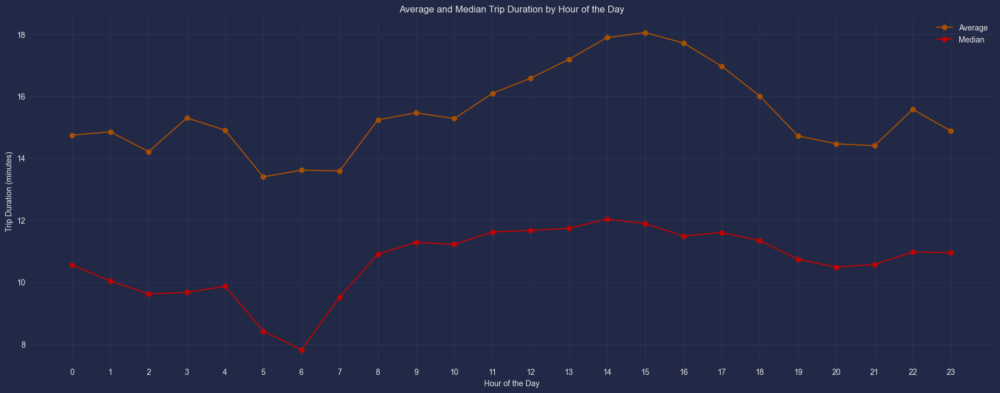

In [19]:

hourly_stats = taxi_data.groupby('pickup_hour')['trip_duration_minutes'].agg(['count', 'mean', 'median'])


# Plotting line plots for average and median trip duration by hour
plt.plot(hourly_stats.index, hourly_stats['mean'], marker='o', color='#A64F03', label='Average')
plt.plot(hourly_stats.index, hourly_stats['median'], marker='o', color='#BF0404', label='Median')
plt.title('Average and Median Trip Duration by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Trip Duration (minutes)')
plt.xticks(np.arange(24))
plt.legend()
plt.grid(True)
plt.show()


---


## Day of the Week Analysis 📅

This section investigates variations in trip durations and volumes between weekdays and weekends, providing insights into weekly travel patterns.


### Is there a difference in trip duration between weekdays and weekends?


In [20]:
# Weekdays (0-4) vs. Weekends (5-6)
taxi_data['weekend'] = taxi_data['day_of_week'].apply(lambda x: 'Weekend' if x >= 5 else 'Weekday')

# Average trip duration comparison between weekdays and weekends
avg_duration_comparison = taxi_data.groupby('weekend')['trip_duration_minutes'].mean()


print("Average Trip Duration Comparison:")
print(avg_duration_comparison)


Average Trip Duration Comparison:
weekend
Weekday    15.985198
Weekend    14.917505
Name: trip_duration_minutes, dtype: float64


### What is the distribution of trip start times by day of the week?


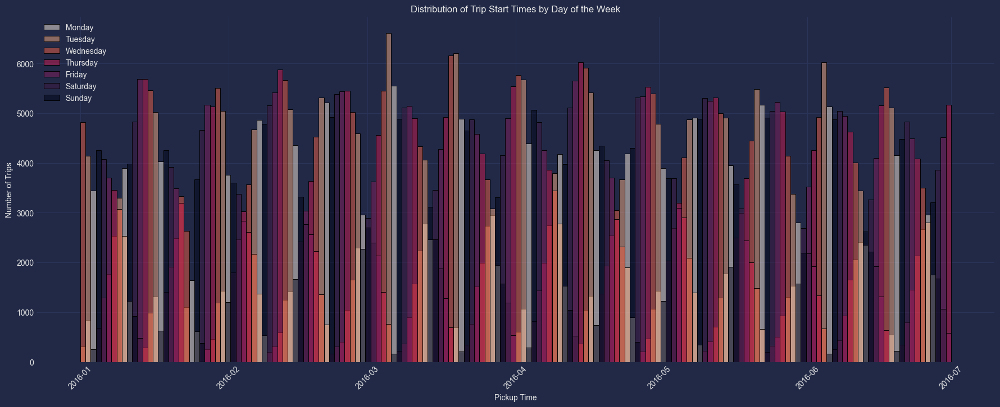

In [21]:
sns.histplot(data=taxi_data, x='pickup_datetime', bins=24*7, hue='day_of_week', kde=False, palette='rocket')
plt.title('Distribution of Trip Start Times by Day of the Week')
plt.xlabel('Pickup Time')
plt.ylabel('Number of Trips')
plt.xticks(rotation=45)
plt.legend(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
plt.show()

### What are the average trip durations over the days of the week?


In [22]:
average_duration_by_day = taxi_data.groupby('day_of_week')['trip_duration_minutes'].mean()
average_duration_by_day

day_of_week
0    14.760901
1    16.013665
2    16.108735
3    16.499644
4    16.367465
5    15.074182
6    14.740277
Name: trip_duration_minutes, dtype: float64

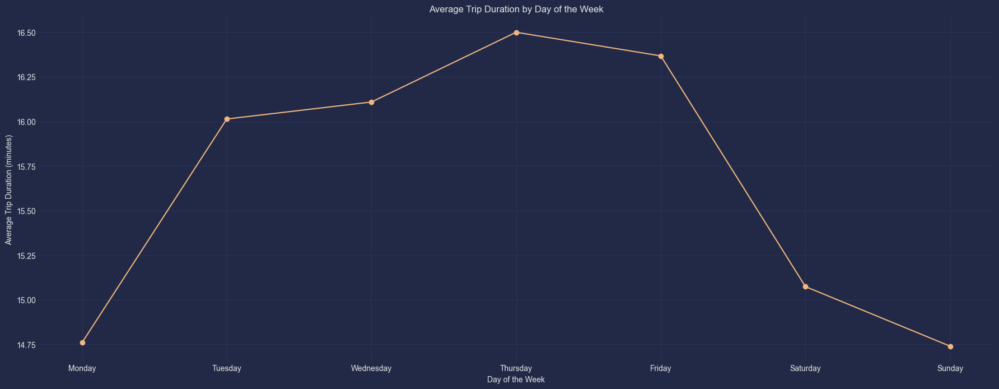

In [23]:

# Plotting the daily average trip duration
plt.plot(average_duration_by_day.index, average_duration_by_day.values, color='#F2B680', marker='o', linestyle='-')
plt.title('Average Trip Duration by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Average Trip Duration (minutes)')
plt.xticks(range(7), labels=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
plt.grid(True)
plt.show()


---


## Temporal Trends Analysis

This section analyzes longer-term trends in trip durations, looking for seasonal patterns, monthly variations, and the impact of holidays or major events.


### Are there seasonal or monthly trends in trip duration?


In [24]:
season_mapping = {1: 'Winter', 2: 'Spring', 3: 'Summer', 4: 'Autumn'}

taxi_data['season'] = taxi_data['season'].map(season_mapping)


In [25]:
avg_duration_by_month = taxi_data.groupby('month')['trip_duration'].mean()
avg_duration_by_month

month
1    909.250561
2    881.227054
3    927.167474
4    949.107310
5    979.653225
6    997.632524
Name: trip_duration, dtype: float64

In [26]:
avg_duration_by_season = taxi_data.groupby('season')['trip_duration'].mean()
avg_duration_by_season

season
Spring    951.706711
Summer    997.632524
Winter    894.971382
Name: trip_duration, dtype: float64

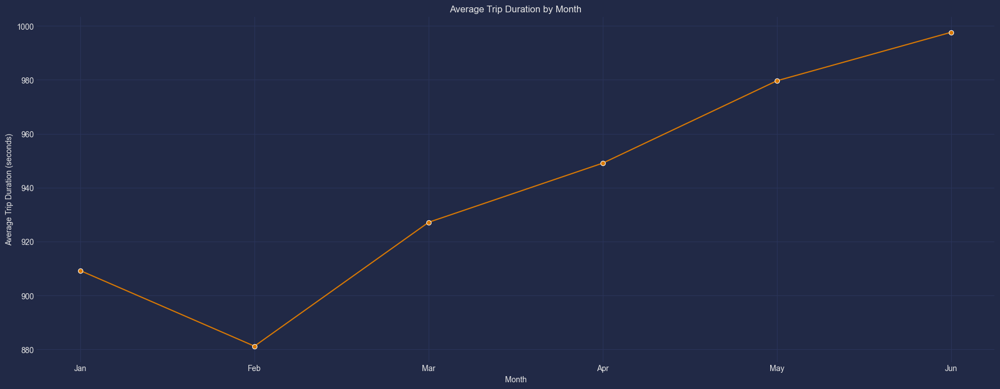

In [27]:
sns.lineplot(data=avg_duration_by_month, marker='o', color='#D97904')
plt.title('Average Trip Duration by Month')
plt.xlabel('Month')
plt.ylabel('Average Trip Duration (seconds)')
plt.xticks(range(1, 7), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun'])
plt.grid(True)
plt.show()


- Trip durations generally increase from January to June, with the longest average durations observed in June.


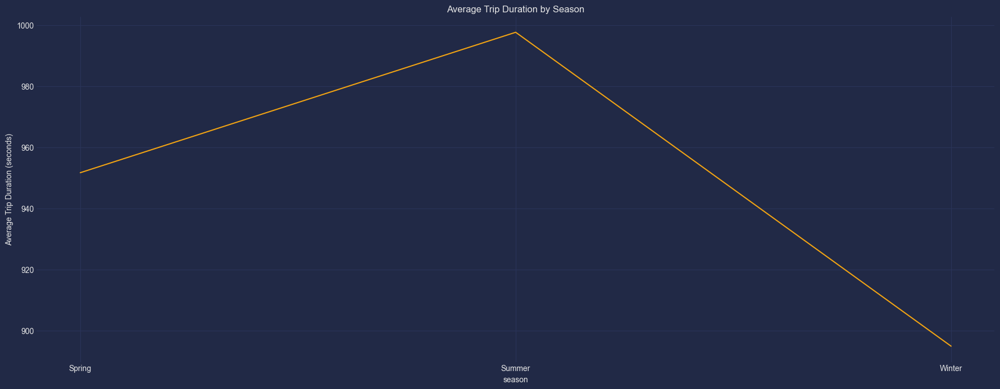

In [28]:
sns.lineplot(data=avg_duration_by_season, color='#F2A413')
plt.title('Average Trip Duration by Season')
plt.ylabel('Average Trip Duration (seconds)')
plt.grid(True)
plt.show()

- Regarding seasons, summer has the highest average trip duration, followed by spring and winter. This could be due to increased travel or tourism during the warmer months, leading to longer trips.


### Can we detect any long-term patterns or anomalies in trip durations over time?


In [29]:
daily_avg_duration = taxi_data.groupby('pickup_datetime')['trip_duration_minutes'].mean()
daily_avg_duration

pickup_datetime
2016-01-01 00:00:53    21.566667
2016-01-01 00:01:20    12.266667
2016-01-01 00:01:47    20.066667
2016-01-01 00:02:06    21.833333
2016-01-01 00:02:45     7.416667
                         ...    
2016-06-30 23:58:38    10.933333
2016-06-30 23:58:47    14.150000
2016-06-30 23:58:52     7.866667
2016-06-30 23:59:09    12.566667
2016-06-30 23:59:37    24.033333
Name: trip_duration_minutes, Length: 949811, dtype: float64

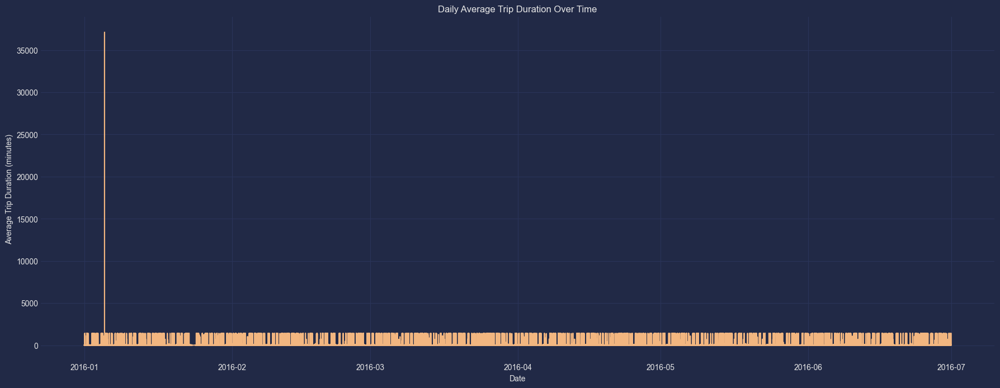

In [30]:
plt.plot(daily_avg_duration.index, daily_avg_duration.values, color='#F2B680')
plt.title('Daily Average Trip Duration Over Time')
plt.xlabel('Date')
plt.ylabel('Average Trip Duration (minutes)')
plt.grid(True)
plt.show()

In [31]:
daily_avg_duration.mean()

15.680859215967995

In [32]:
max_date = daily_avg_duration.idxmax()

print(f"Date of Maximum Average Trip Duration {daily_avg_duration.max()} in average trip duration: {max_date}")


Date of Maximum Average Trip Duration 37126.86666666667 in average trip duration: 2016-01-05 06:14:15


Remove Outliers


In [33]:
taxi_data = taxi_data.drop(taxi_data[taxi_data['pickup_datetime'] == '2016-01-05 06:14:15'].index)


In [34]:
daily_avg_duration = taxi_data.groupby('day_of_week')['trip_duration_minutes'].mean()
daily_avg_duration

day_of_week
0    14.760901
1    15.742669
2    16.108735
3    16.499644
4    16.367465
5    15.074182
6    14.740277
Name: trip_duration_minutes, dtype: float64

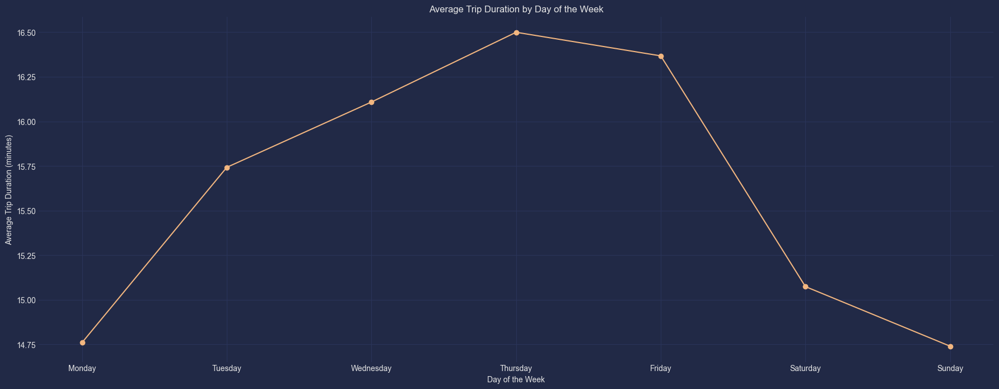

In [35]:

# Plotting the daily average trip duration
plt.plot(daily_avg_duration.index, daily_avg_duration.values, color='#F2B680', marker='o', linestyle='-')
plt.title('Average Trip Duration by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Average Trip Duration (minutes)')
plt.xticks(range(7), labels=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
plt.grid(True)
plt.show()


Observations:

- Trip durations tend to be slightly longer on Wednesdays, Thursdays, and Fridays compared to other days of the week.
- The shortest average trip durations are observed on Sundays and Mondays.
- There is a noticeable increase in trip duration towards the middle of the week, peaking on Thursdays, before decreasing slightly towards the weekend.


---


## Spatial Analysis 🗺️

This section explores the geographic aspects of trip data, including common locations and the relationship between distance and trip duration.


### Distance Analysis


#### Calculate the straight-line distance (Haversine distance) and analyze its correlation with trip duration.


In [36]:
def haversine(lon1, lat1, lon2, lat2):
    from math import radians, cos, sin, asin, sqrt
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    km = 6371 * c
    return km


In [37]:
taxi_data['trip_distance'] = taxi_data.apply(lambda row: haversine(row['pickup_longitude'], row['pickup_latitude'], row['dropoff_longitude'], row['dropoff_latitude']), axis=1)


In [38]:
correlation = taxi_data['trip_distance'].corr(taxi_data['trip_duration_minutes'])
print(f"Correlation between trip distance and trip duration: {correlation}")


Correlation between trip distance and trip duration: 0.16186585485540025


- The correlation coefficient of 0.1318 indicates a weak positive relationship between trip distance and trip duration.
- This suggests that, while there is a tendency for longer distances to be associated with longer trip durations, the relationship is not strong. Other factors such as traffic conditions, route taken, and stops might have significant influences on trip duration.


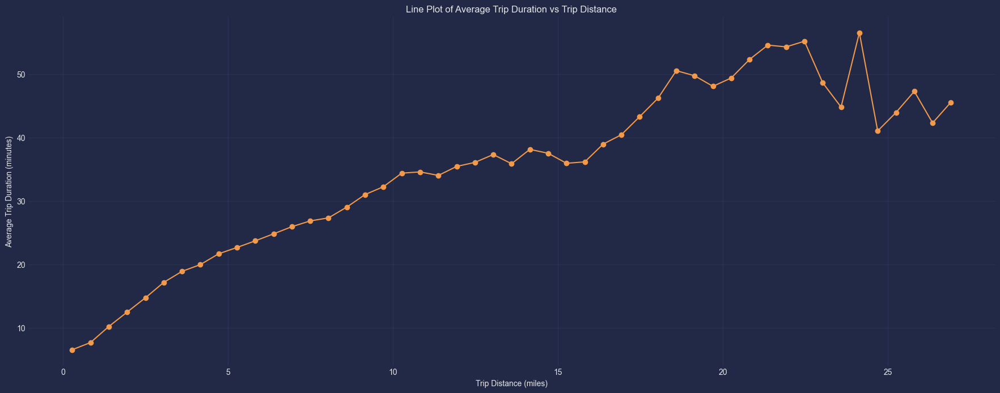

In [39]:
bins = np.linspace(0, taxi_data['trip_distance'].max(), 50)

taxi_data['distance_bin'] = pd.cut(taxi_data['trip_distance'], bins)
mean_durations = taxi_data.groupby('distance_bin')['trip_duration_minutes'].mean()

# Calculate the mid-point of each bin for plotting
bin_midpoints = [bin.mid for bin in mean_durations.index]

plt.plot(bin_midpoints, mean_durations, marker='o', linestyle='-', color='#F2994B')
plt.title('Line Plot of Average Trip Duration vs Trip Distance')
plt.xlabel('Trip Distance (miles)')
plt.ylabel('Average Trip Duration (minutes)')
plt.grid(True)
plt.show()

- The line plot shows how the average trip duration changes as trip distance increases. Although there is a general trend of increasing duration with increasing distance, there are fluctuations in average duration across different distance intervals. This suggests that other factors may also influence trip duration.


### Geographic Analysis 🤔🗺️


#### What are the most common pickup and drop-off locations? 📌


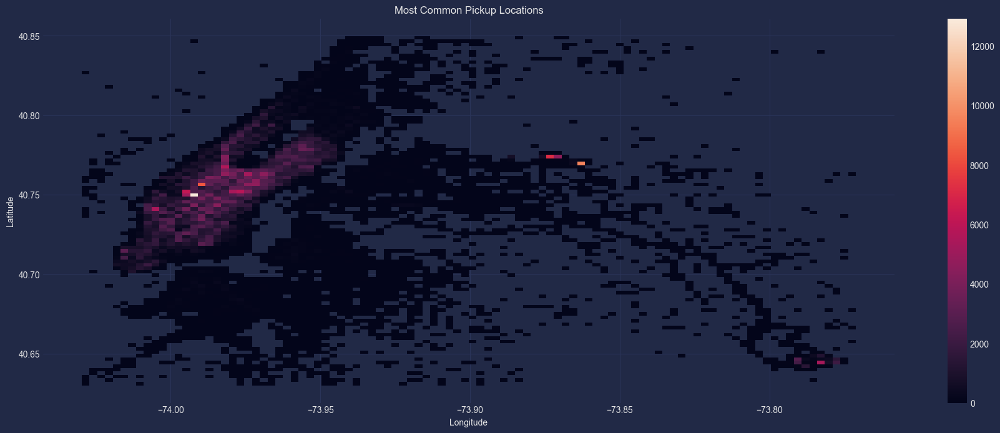

In [40]:
sns.histplot(x=taxi_data['pickup_longitude'], y=taxi_data['pickup_latitude'], bins=100, cmap='rocket', cbar=True)
plt.title('Most Common Pickup Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

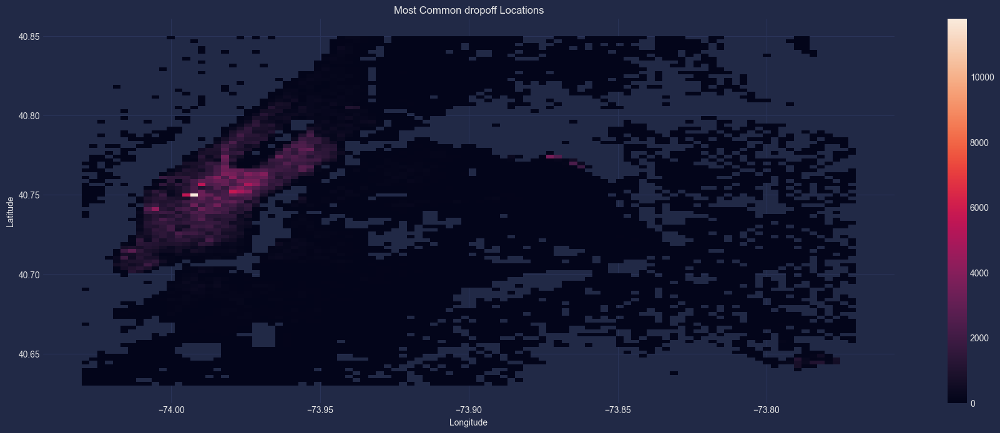

In [41]:
sns.histplot(x=taxi_data['dropoff_longitude'], y=taxi_data['dropoff_latitude'], bins=100, cmap='rocket', cbar=True)
plt.title('Most Common dropoff Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

#### How does trip duration vary by geographic location?


In [42]:
taxi_data_sample = taxi_data.sample(150000)

In [43]:

fig = px.scatter_mapbox(taxi_data_sample, lat="pickup_latitude", lon="pickup_longitude", 
                        color="trip_distance",size='trip_duration_minutes',
                        color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,hover_data=["trip_distance", "trip_duration_minutes"])

fig.update_layout(mapbox_style="open-street-map")
# fig.update_layout(mapbox_style="cartography") 
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


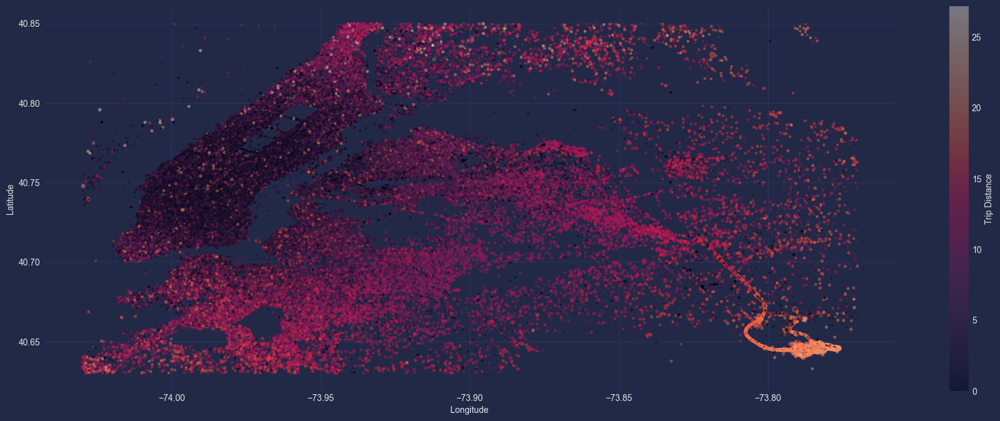

In [44]:

longitude = list(taxi_data.pickup_longitude) + list(taxi_data.dropoff_longitude)
latitude = list(taxi_data.pickup_latitude) + list(taxi_data.dropoff_latitude)

trip_distance = list(taxi_data.trip_distance) * 2
trip_duration_minutes = list(taxi_data.trip_duration_minutes) * 2


sc = plt.scatter(longitude, latitude, c=trip_distance, s=np.sqrt(trip_duration_minutes), cmap='rocket', alpha=0.4)

plt.colorbar(sc, label='Trip Distance')

plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()


---


## Passenger Analysis 🧑‍🤝‍🧑📊

This section explores the relationship between trip duration, passenger count, and trip distance.


### How does trip duration correlate with passenger count?


In [45]:
from scipy.stats import pearsonr

# Calculate Pearson correlation coefficient and p-value
pearson_corr, pearson_p_value = pearsonr(taxi_data['trip_duration_minutes'], taxi_data['passenger_count'])

print("Pearson correlation coefficient:", pearson_corr)
print("p-value:", pearson_p_value)


Pearson correlation coefficient: 0.01544357075793383
p-value: 4.296478429708006e-53


- Observations:
Weak Correlation: The Pearson correlation coefficient of 0.0154 suggests a very weak positive correlation between trip duration and passenger count. This indicates that there is almost no linear relationship between these two variables. In simpler terms, knowing the number of passengers doesn't tell us much about how long the trip will take, and vice versa.


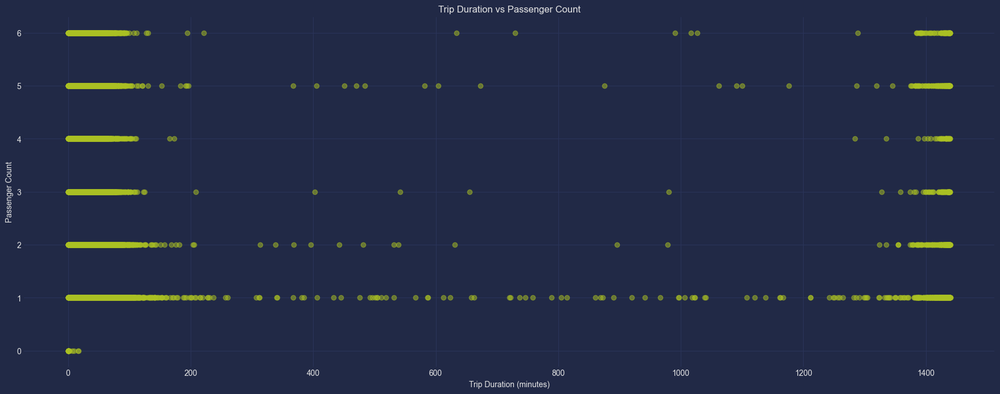

In [46]:
plt.scatter(taxi_data['trip_duration_minutes'], taxi_data['passenger_count'], alpha=0.5,color='#abc123')
plt.title('Trip Duration vs Passenger Count')
plt.xlabel('Trip Duration (minutes)')
plt.ylabel('Passenger Count')
plt.grid(True)
plt.show()

### Do trips with more passengers tend to be longer?


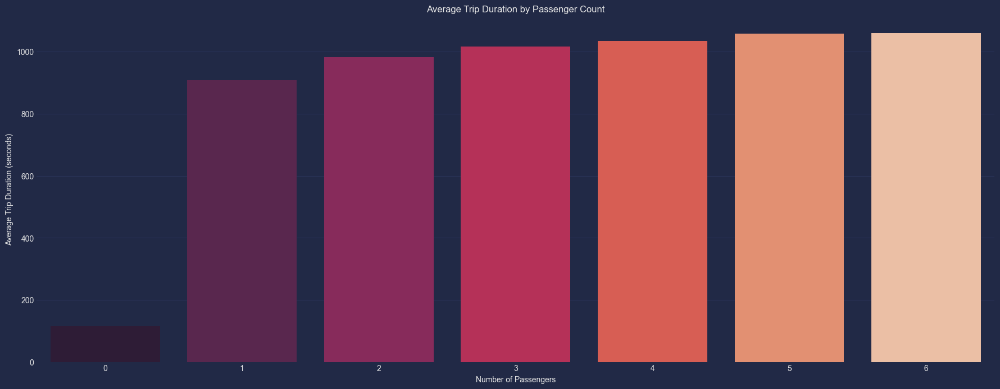

In [47]:
avg_duration_by_passenger_count = taxi_data.groupby('passenger_count')['trip_duration'].mean()

sns.barplot(x=avg_duration_by_passenger_count.index, y=avg_duration_by_passenger_count.values, palette='rocket')
plt.title('Average Trip Duration by Passenger Count')
plt.xlabel('Number of Passengers')
plt.ylabel('Average Trip Duration (seconds)')
plt.show()

- The trend suggests that, on average, trips with more passengers tend to be slightly longer. However, the difference in average trip duration between different passenger counts is relatively small.


### What is the relationship between passenger count and trip distance?


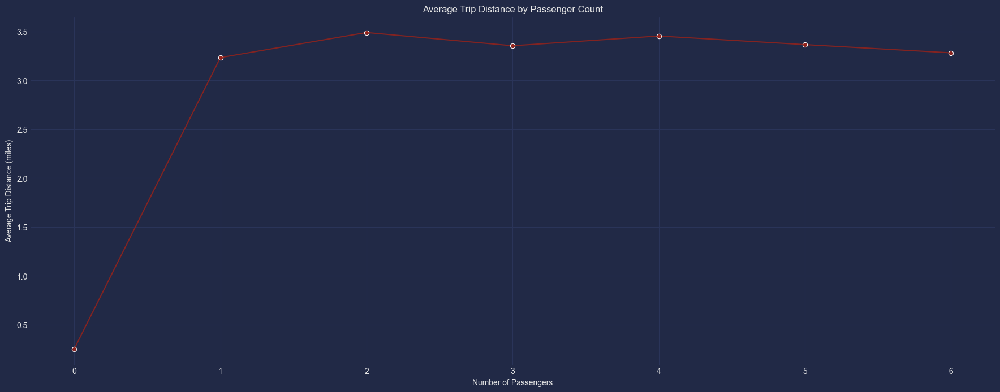

In [48]:
avg_distance_by_passenger_count = taxi_data.groupby('passenger_count')['trip_distance'].mean()

sns.lineplot(x=avg_distance_by_passenger_count.index, y=avg_distance_by_passenger_count.values, marker='o', color='#ae2111b2')
plt.title('Average Trip Distance by Passenger Count')
plt.xlabel('Number of Passengers')
plt.ylabel('Average Trip Distance (miles)')
plt.grid(True)
plt.show()

- Based on these averages, there doesn't appear to be a significant relationship between passenger count and trip distance.


---


## Vendor Analysis 🚖💼

This section aims to compare trip durations between different vendors, specifically Vendor 1 and Vendor 2, to identify any significant differences.


### Compare trip durations and Distance between different vendors.


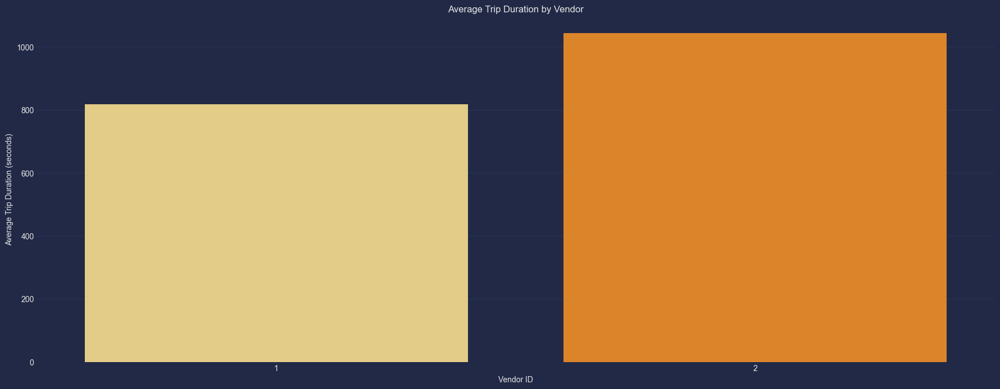

In [49]:
avg_duration_by_vendor = taxi_data.groupby('vendor_id')['trip_duration'].mean()
sns.barplot(x=avg_duration_by_vendor.index, y=avg_duration_by_vendor.values, palette=['#F2D479','#F9840D'])
plt.title('Average Trip Duration by Vendor')
plt.xlabel('Vendor ID')
plt.ylabel('Average Trip Duration (seconds)')
plt.show()

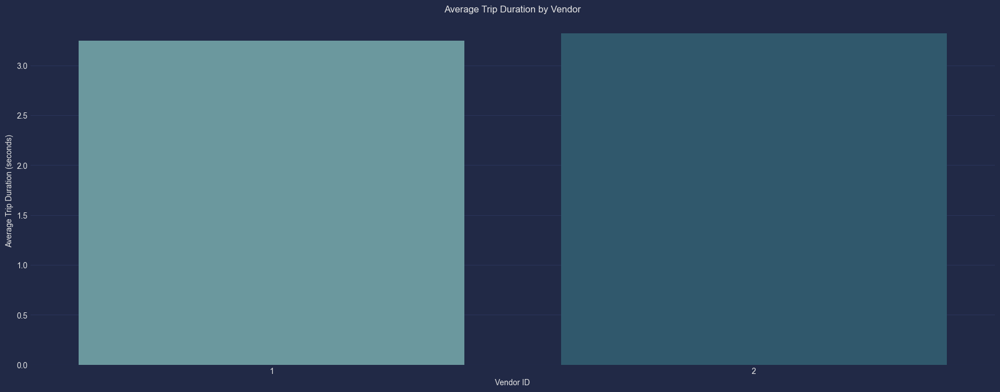

In [50]:
avg_duration_by_vendor = taxi_data.groupby('vendor_id')['trip_distance'].mean()
sns.barplot(x=avg_duration_by_vendor.index, y=avg_duration_by_vendor.values, palette=['#639FA6','#265C76'])
plt.title('Average Trip Duration by Vendor')
plt.xlabel('Vendor ID')
plt.ylabel('Average Trip Duration (seconds)')
plt.show()

### Is there a significant difference in trip durations between Vendor 1 and Vendor 2?


In [51]:
from scipy import stats

# Separate trip durations for Vendor 1 and Vendor 2
vendor_1_durations = taxi_data[taxi_data['vendor_id'] == 1]['trip_duration']
vendor_2_durations = taxi_data[taxi_data['vendor_id'] == 2]['trip_duration']

# *t-test
t_statistic, p_value = stats.ttest_ind(vendor_1_durations, vendor_2_durations)

# Set significance level
alpha = 0.05

# Check if the p-value is less than alpha
if p_value < alpha:
    print("There is a significant difference in trip durations between Vendor 1 and Vendor 2 (p < 0.05)")
else:
    print("There is no significant difference in trip durations between Vendor 1 and Vendor 2 (p >= 0.05)")


There is a significant difference in trip durations between Vendor 1 and Vendor 2 (p < 0.05)


In [52]:
vendor_1_mean_duration = vendor_1_durations.mean()
vendor_2_mean_duration = vendor_2_durations.mean()

# Print the means
print("Mean trip duration for Vendor 1:", vendor_1_mean_duration)
print("Mean trip duration for Vendor 2:", vendor_2_mean_duration)

# Compare means (higher value indicates longer trips)
if vendor_1_mean_duration > vendor_2_mean_duration:
  print("Vendor 1 has longer trips on average.")
else:
  print("Vendor 2 has longer trips on average.")

Mean trip duration for Vendor 1: 817.9329043957385
Mean trip duration for Vendor 2: 1043.5159684707319
Vendor 2 has longer trips on average.


- we can see that `Vendor 2` does indeed have longer trip durations on average `(1043.52)` compared to `Vendor 1` `(817.93)`. This further strengthens the conclusion from the **t-test** that there's a significant difference in trip durations between the two vendors.


---


## Store and Forward Flag Analysis 🗂️🚖

### Overview

This section examines the impact of the "store and forward" flag on taxi trips, indicating whether trip records were held in the vehicle memory due to a lack of server connection.

### Insights

By analyzing the "store and forward" flag, we aim to understand its influence on trip duration and potential implications for taxi service efficiency and reliability.


### What percentage of trips were marked as "store and forward"?


In [53]:
store_and_forward_trips = taxi_data[taxi_data['store_and_fwd_flag'] == 'Y'].shape[0]
total_trips = taxi_data.shape[0]
percentage_store_and_forward = (store_and_forward_trips / total_trips) * 100

print(f"Percentage of 'store and forward' trips: {percentage_store_and_forward:.2f}%")


Percentage of 'store and forward' trips: 0.55%


### Is there any correlation between "store and forward" trips and trip duration?

In [54]:
# Assign binary values to store_and_fwd_flag for correlation calculation
taxi_data['store_and_fwd_flag_binary'] = taxi_data['store_and_fwd_flag'].apply(lambda x: 1 if x == 'Y' else 0)

correlation = taxi_data['store_and_fwd_flag_binary'].corr(taxi_data['trip_duration'])

print(f"Correlation between 'store and forward' trips and trip duration: {correlation:.2f}")


Correlation between 'store and forward' trips and trip duration: 0.00


### Are there any noticeable patterns in the distribution of "store and forward" trips throughout the day or week?

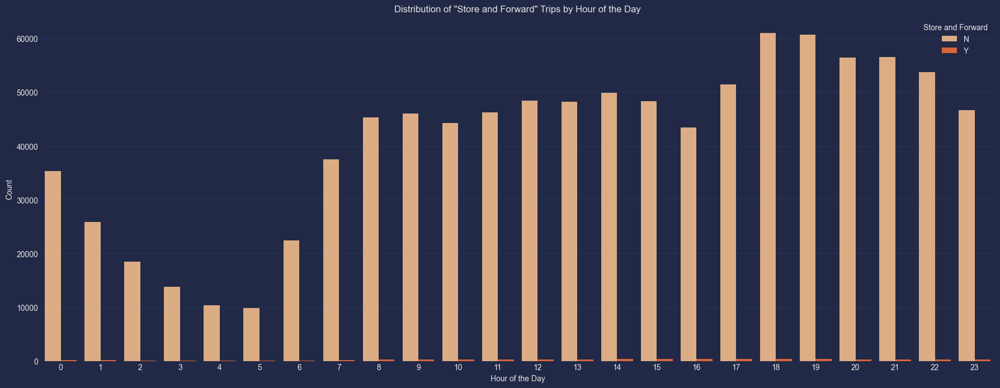

In [55]:
sns.countplot(x='pickup_hour', hue='store_and_fwd_flag', data=taxi_data,palette=['#EBAA76','#F25922'])
plt.title('Distribution of "Store and Forward" Trips by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Count')
plt.legend(title='Store and Forward')
plt.show()

### Average trip distance

In [56]:
average_distance = taxi_data.groupby('store_and_fwd_flag')['trip_distance'].mean()

average_distance


store_and_fwd_flag
N    3.279564
Y    4.764185
Name: trip_distance, dtype: float64

---


## Weather Data Fields

- **date**: The date corresponding to the weather measurements 📅
- **maximum temperature**: The highest temperature recorded on that date 🌡️
- **minimum temperature**: The lowest temperature recorded on that date 🌡️
- **average temperature**: The average temperature for that date 🌡️
- **precipitation**: The amount of precipitation (rainfall) on that date ☔
- **snow fall**: The amount of snowfall on that date ❄️
- **snow depth**: The depth of snow accumulation on that date 🌨️

In [57]:
taxi_data['pickup_datetime'] = pd.to_datetime(taxi_data['pickup_datetime'])
taxi_data['date'] = taxi_data['pickup_datetime'].dt.date

In [58]:
weather_data['date'] = pd.to_datetime(weather_data['date'], format='%d-%m-%Y')

In [59]:
weather_data

,date,maximum temperature,minimum temperature,average temperature,precipitation,snow fall,snow depth
0,2016-01-01,42,34,38.0,0.00,0.0,0
1,2016-01-02,40,32,36.0,0.00,0.0,0
2,2016-01-03,45,35,40.0,0.00,0.0,0
3,2016-01-04,36,14,25.0,0.00,0.0,0
4,2016-01-05,29,11,20.0,0.00,0.0,0
...,...,...,...,...,...,...,...
361,2016-12-27,60,40,50.0,0,0,0
362,2016-12-28,40,34,37.0,0,0,0
363,2016-12-29,46,33,39.5,0.39,0,0
364,2016-12-30,40,33,36.5,0.01,T,0


In [60]:
taxi_data

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,pickup_hour,trip_duration_minutes,day_of_week,year,month,season,weekend,trip_distance,distance_bin,store_and_fwd_flag_binary,date
0,id2793718,2,2016-06-08 07:36:19,1,-73.985611,40.735943,-73.980331,40.760468,N,1040,7,17.333333,2,2016,6,Summer,Weekday,2.763050,"(2.22, 2.775]",0,2016-06-08
1,id3485529,2,2016-04-03 12:58:11,1,-73.978394,40.764351,-73.991623,40.749859,N,827,12,13.783333,6,2016,4,Spring,Weekend,1.959178,"(1.665, 2.22]",0,2016-04-03
2,id1816614,2,2016-06-05 02:49:13,5,-73.989059,40.744389,-73.973381,40.748692,N,614,2,10.233333,6,2016,6,Summer,Weekend,1.404772,"(1.11, 1.665]",0,2016-06-05
3,id1050851,2,2016-05-05 17:18:27,2,-73.990326,40.731136,-73.991264,40.748917,N,867,17,14.450000,3,2016,5,Spring,Weekday,1.978660,"(1.665, 2.22]",0,2016-05-05
4,id0140657,1,2016-05-12 17:43:38,4,-73.789497,40.646675,-73.987137,40.759232,N,4967,17,82.783333,3,2016,5,Spring,Weekday,20.837745,"(20.532, 21.087]",0,2016-05-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,id2875371,2,2016-03-25 15:48:58,1,-73.959106,40.771770,-73.953995,40.786312,N,254,15,4.233333,4,2016,3,Spring,Weekday,1.673259,"(1.665, 2.22]",0,2016-03-25
999996,id1038420,2,2016-05-04 19:36:44,1,-73.970978,40.764015,-73.956230,40.777851,N,434,19,7.233333,2,2016,5,Spring,Weekday,1.977187,"(1.665, 2.22]",0,2016-05-04
999997,id3238884,2,2016-05-19 08:50:41,2,-73.982178,40.771240,-73.970749,40.758968,N,1306,8,21.766667,3,2016,5,Spring,Weekday,1.669878,"(1.665, 2.22]",0,2016-05-19
999998,id3652642,2,2016-04-04 14:37:59,6,-73.982513,40.765533,-74.005974,40.711842,N,2317,14,38.616667,0,2016,4,Spring,Weekday,6.288950,"(6.104, 6.659]",0,2016-04-04


In [61]:
taxi_data['date'] = pd.to_datetime(taxi_data['date'], errors='coerce')

# Convert 'date' column in weather_data to datetime
weather_data['date'] = pd.to_datetime(weather_data['date'], errors='coerce')

taxi_data['date'] = pd.to_datetime(taxi_data['date'], errors='coerce')

# Convert 'date' column in weather_data to datetime
weather_data['date'] = pd.to_datetime(weather_data['date'], errors='coerce')
taxi_data = taxi_data.dropna(subset=['date'])
weather_data = weather_data.dropna(subset=['date'])

# Now merge the dataframes on the 'date' column
merged_data = pd.merge(taxi_data, weather_data, on='date')

In [62]:
merged_data.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,pickup_hour,trip_duration_minutes,day_of_week,year,month,season,weekend,trip_distance,distance_bin,store_and_fwd_flag_binary,date,maximum temperature,minimum temperature,average temperature,precipitation,snow fall,snow depth
0,id2793718,2,2016-06-08 07:36:19,1,-73.985611,40.735943,-73.980331,40.760468,N,1040,7,17.333333,2,2016,6,Summer,Weekday,2.763050,"(2.22, 2.775]",0,2016-06-08,67,52,59.5,0.45,0.0,0
1,id2885693,1,2016-06-08 21:11:45,1,-73.966011,40.790024,-74.002197,40.742065,N,3109,21,51.816667,2,2016,6,Summer,Weekday,6.142086,"(6.104, 6.659]",0,2016-06-08,67,52,59.5,0.45,0.0,0
2,id2537758,1,2016-06-08 11:11:31,1,-74.007980,40.732349,-73.998886,40.733234,N,337,11,5.616667,2,2016,6,Summer,Weekday,0.772566,"(0.555, 1.11]",0,2016-06-08,67,52,59.5,0.45,0.0,0
3,id1393747,1,2016-06-08 02:47:37,1,-73.908630,40.774769,-73.906433,40.759869,N,400,2,6.666667,2,2016,6,Summer,Weekday,1.667129,"(1.665, 2.22]",0,2016-06-08,67,52,59.5,0.45,0.0,0
4,id0866387,1,2016-06-08 16:22:27,1,-74.012177,40.707348,-73.985573,40.755512,N,1420,16,23.666667,2,2016,6,Summer,Weekday,5.805843,"(5.549, 6.104]",0,2016-06-08,67,52,59.5,0.45,0.0,0
